# Super Resolution with SRGAN

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
%cd '/content/drive/MyDrive/AIFFEL'

/content/drive/MyDrive/AIFFEL


- SRGAN을 활용해 Super Resolution을 진행해보자
### 프로젝트 1-1
고해상도 이미지 -> 1/4로 resize -> 저해상도 이미지로 부터 SRGAN으로 고해상도 이미지 생성
### 프로젝트 1-2
저해상도 이미지 -> SRGAN으로 고해상도 이미지 생성
### 프로젝트 2
gif -> 프레임들 -> SRGAN으로 고해상도 이미지 생성 -> 프레임들로 gif 생성

# 프로젝트 1-1. 고해상도 이미지 축소 후 SRGAN으로 고해상도 이미지 생성

## step1) 고해상도 이미지 불러오기

In [3]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import tensorflow as tf
import tensorflow_datasets as tfds

from tensorflow.keras import layers, Sequential # SRCNN
from tensorflow.keras import Input, Model, layers # SRGAN

from tensorflow.python.keras import applications # pre-trained VGG loading

from tensorflow.keras import losses, metrics, optimizers

# Super Resolution PSNR, SSIM 계산
from skimage.metrics import peak_signal_noise_ratio, structural_similarity

고화질 이미지 shape : (2835, 1979, 3)


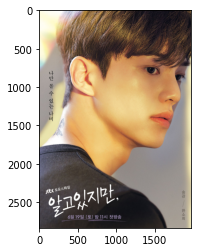

In [47]:
hr_image_bgr = cv2.imread('super_resolution/songgang.jpg')
hr_image = cv2.cvtColor(hr_image_bgr, cv2.COLOR_BGR2RGB)
print(f'고화질 이미지 shape : {hr_image.shape}')
plt.imshow(hr_image)

## step2) 고해상도 이미지 축소
- 원본 가로, 세로 픽셀 수의 1/4로 이미지를 축소한다.
- 축소할 때 bicubic interpolation을 적용한다.

In [48]:
h,w, _ = hr_image.shape
print(f'가로 1/4 : {h/4}\n세로 1/4 : {w/4}')

가로 1/4 : 708.75
세로 1/4 : 494.75


저화질 이미지 shape : (708, 494, 3)


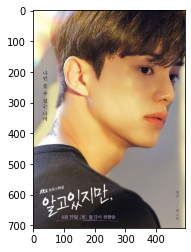

In [49]:
lr_image = cv2.resize(hr_image, dsize=(w//4,h//4))
print(f'저화질 이미지 shape : {lr_image.shape}')
plt.imshow(lr_image)

저화질 이미지 shape : (708, 494, 3)


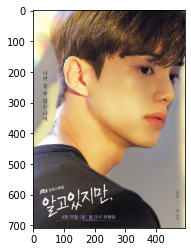

In [50]:
lr_image = cv2.resize(hr_image, dsize=(w//4,h//4), interpolation=cv2.INTER_CUBIC)
print(f'저화질 이미지 shape : {lr_image.shape}')
plt.imshow(lr_image)

## step3) SRGAN으로 Super Resolution

In [8]:
model_file = 'super_resolution/srgan_G.h5'
srgan = tf.keras.models.load_model(model_file)

In [9]:
def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

In [10]:
srgan_image = apply_srgan(lr_image)

## step4) Bicubic Interpolation을 적용한 Super Resolution
- 원본 픽셀 수의 1/4로 축소한 이미지를 `cv2.resize()`를 통해 Bicubic Interpolation 기법을 적용해서 가로 세로 픽셀 수의 4배로 늘리자.

bicubic 이미지 shape : (2835, 1979, 3)


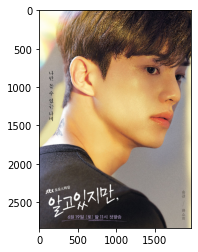

In [51]:
bicubic_image = cv2.resize(lr_image, dsize=(w,h), interpolation=cv2.INTER_CUBIC)
print(f'bicubic 이미지 shape : {bicubic_image.shape}')
plt.imshow(bicubic_image)

## step5) Super Resolution 결과 시각화
- 원본 고해상도 이미지와 Bicubic 결과, SRGAN 결과를 시각화해보자.

In [12]:
# 이미지의 특정 부분을 잘라내는 함수를 정의합니다.
def crop(image, left_top, x=200, y=200):
    return image[left_top[0]:(left_top[0]+x), left_top[1]:(left_top[1]+y), :]

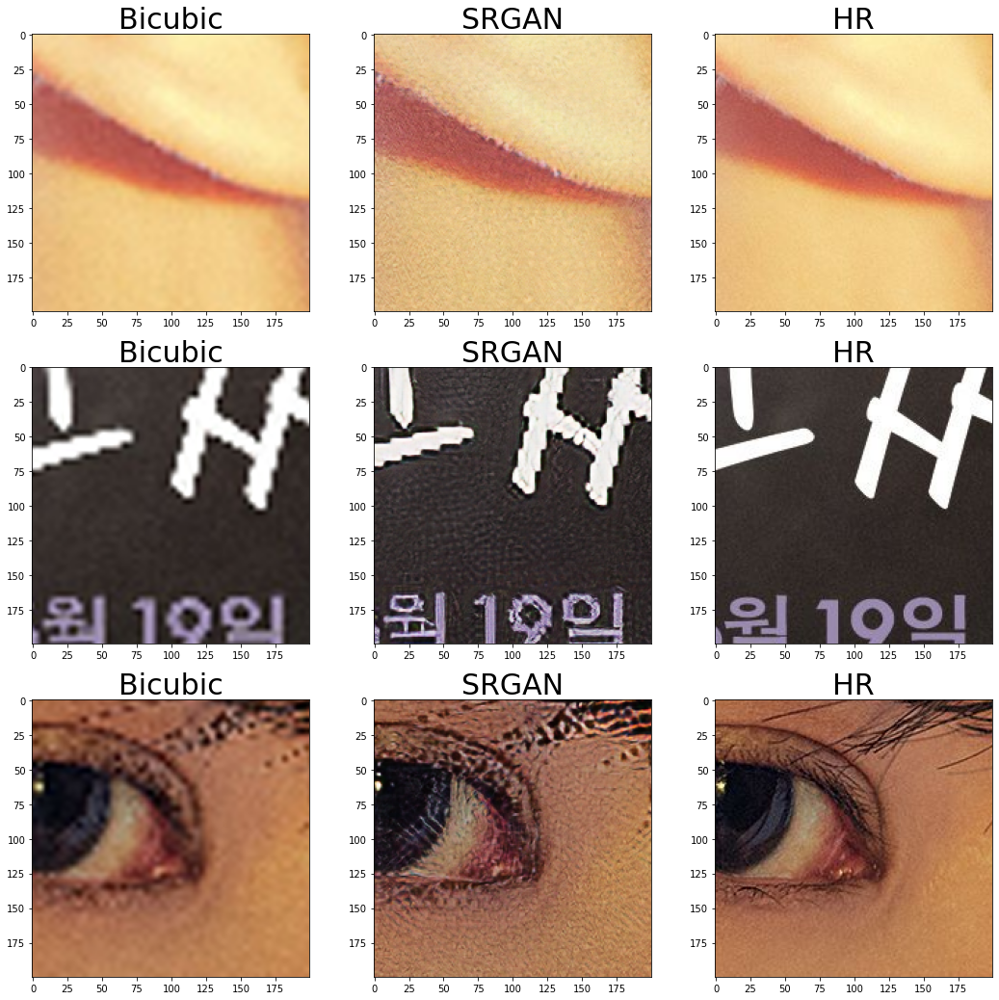

In [13]:
# 자세히 시각화 하기 위해 3개 영역을 잘라냅니다.
# 아래는 잘라낸 부분의 좌상단 좌표 3개 입니다.
left_tops = [(1000,500), (2500,400), (700,1450)]
images = []
for left_top in left_tops:
    img1 = crop(bicubic_image, left_top, 200, 200)
    img2 = crop(srgan_image, left_top, 200, 200)
    img3 = crop(hr_image, left_top, 200, 200)
    images.extend([img1, img2, img3])

labels = ["Bicubic", "SRGAN", "HR"] * 3

plt.figure(figsize=(18,18))
for i in range(9):
    plt.subplot(3,3,i+1) 
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=30)

## step6) Super Resolution 결과 분석

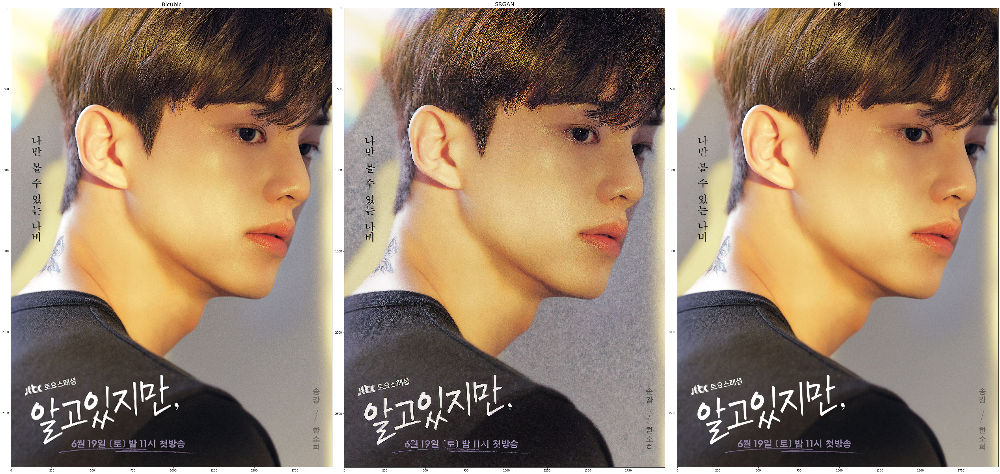

In [52]:
images = [bicubic_image, srgan_image, hr_image]
titles = ["Bicubic", "SRGAN", "HR"]
plt.figure(figsize=(50,100))
for i, (image, title) in enumerate(zip(images, titles)):
    plt.subplot(1,3,i+1)
    plt.imshow(image)
    plt.title(title, fontsize=20)
plt.tight_layout()

- 그렇게 좋은 해상도를 보이진 않았다. DIV2K로 학습한 SRGAN 같은 경우 자꾸 없는 질감을 만들어냈다.고화질 이미지가 너무 깨끗했던걸까.
- DIV2K 데이터셋에서 사람의 안면을 포함하는 부분은 5% 이하이고 얼굴이 포함된 이미지 안에서 얼굴이 차지하는 부분은 대부분 10% 미만이라고 한다.(문준원·김재석,"범용 데이터 셋과 얼굴 데이터 셋에 대한 초해상도 융합 기법", 멀티미디어학회 논문지 제22권 제11호, 2019.)
- 그리고 원본 고해상도 이미지에 비해 뒷목 피부 쪽 색상에 흰 끼가 조금 더 도는 것을 볼 수 있었다. 데이터셋에 동양인 데이터가 거의 없었던 것 아닐까 추측해본다.
- DIV2K 데이터셋에 포함된 글씨 부분도 영어가 많고 건축물 등에 포함된 글씨여서 약간 우둘투둘한 글씨가 많았던 반면 제공한 이미지는 굴곡 없이 깔끔한 글씨이다 보니 더 잘 생성해내지 못한 것 같다.
- bicubic을 사용한 이미지는 좋게 말하자면 SRGAN에 비해 픽셀 간 연결이 부드럽고 나쁘게 말하면 그다지 큰 화질 개선이 발생하지 않았다.
- SRGAN도 bicubic 기법에 비해서는 윤곽이 뚜렷한 편이나 원본 고해상도 이미지와 비교했을 때 차이가 심하다.

# 프로젝트 1-2 저해상도 이미지 SRGAN으로 Super Resolution

## step1) 저해상도 이미지 로드

저화질 이미지 shape : (256, 256, 3)


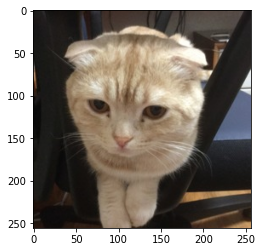

In [53]:
lr_image_bgr = cv2.imread('super_resolution/smallcat.jpg')
lr_image = cv2.cvtColor(lr_image_bgr, cv2.COLOR_BGR2RGB)
print(f'저화질 이미지 shape : {lr_image.shape}')
plt.imshow(lr_image)

In [54]:
h,w, _ = lr_image.shape
print(f'가로 : {h}\n세로 : {w}')
print(f'가로*4 : {h*4}\n세로*4 : {w*4}')

가로 : 256
세로 : 256
가로*4 : 1024
세로*4 : 1024


## step2) SRGAN으로 고해상도 이미지 생성

In [55]:
srgan_hr = apply_srgan(lr_image)

srgan 이미지 shape : (1024, 1024, 3)


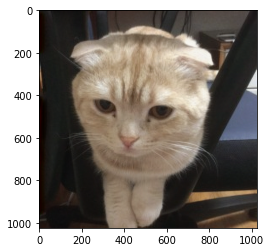

In [56]:
print(f'srgan 이미지 shape : {srgan_hr.shape}')
plt.imshow(srgan_hr)

## step3) Bicubic Interpolation으로 Super Resolution

- 가로, 세로 픽셀 수의 4배를 늘린다.

bicubic 이미지 shape : (1024, 1024, 3)


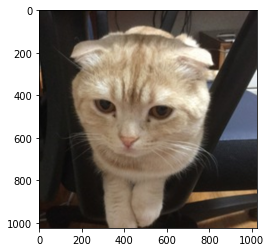

In [57]:
bicubic_image = cv2.resize(lr_image, dsize=(w*4,h*4), interpolation=cv2.INTER_CUBIC)
print(f'bicubic 이미지 shape : {bicubic_image.shape}')
plt.imshow(bicubic_image)

## step4) Bicubic, SRGAN 결과 시각화

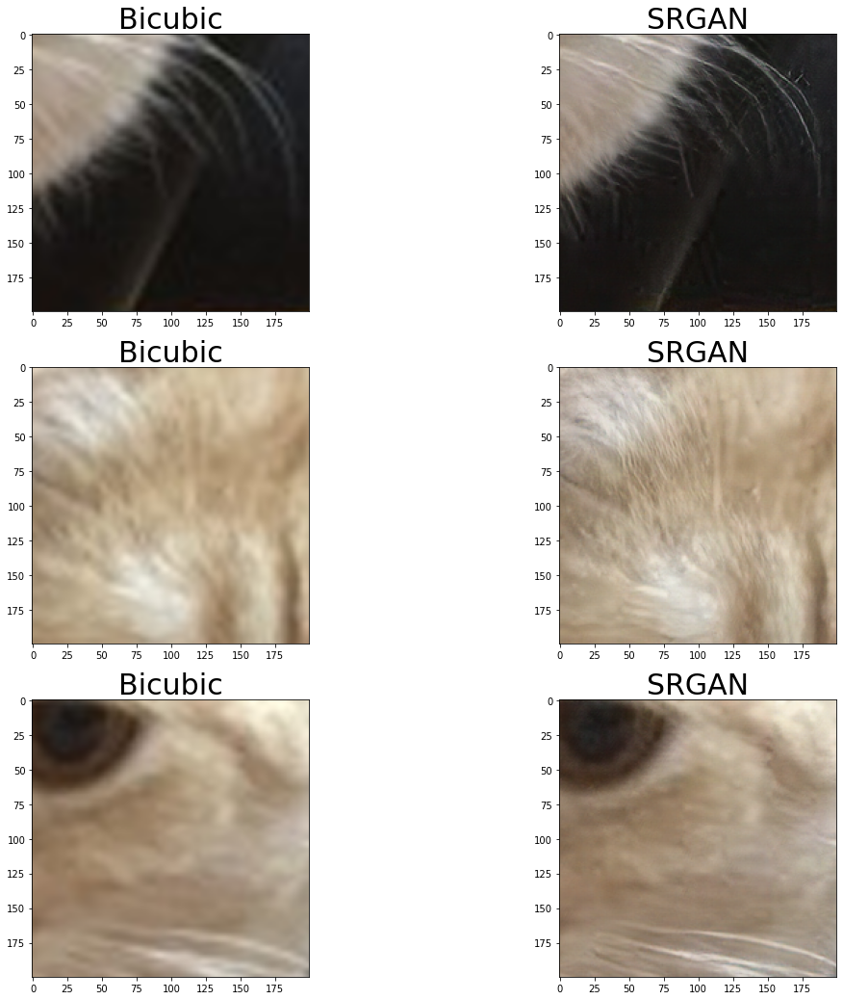

In [58]:
# 자세히 시각화 하기 위해 3개 영역을 잘라냅니다.
# 아래는 잘라낸 부분의 좌상단 좌표 3개 입니다.
left_tops = [(650,650), (200,210), (450,550)]
images = []
for left_top in left_tops:
    img1 = crop(bicubic_image, left_top, 200, 200)
    img2 = crop(srgan_hr, left_top, 200, 200)
    images.extend([img1, img2])

labels = ["Bicubic", "SRGAN"] * 3

plt.figure(figsize=(18,18))
for i in range(6):
    plt.subplot(3,2,i+1) 
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=30)

## step5) SRGAN Super Resolution 결과 분석

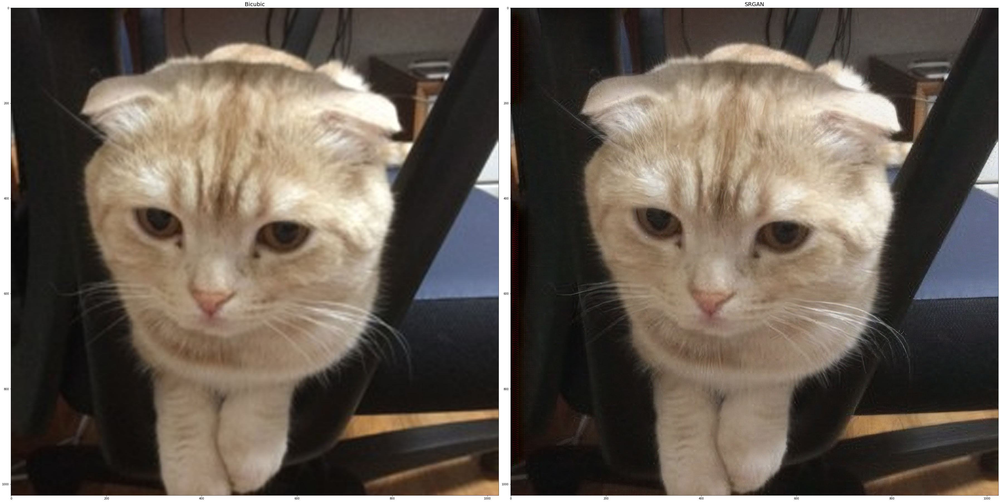

In [59]:
images = [bicubic_image, srgan_hr]
titles = ["Bicubic", "SRGAN"]
plt.figure(figsize=(50,100))
for i, (image, title) in enumerate(zip(images, titles)):
    plt.subplot(1,2,i+1)
    plt.imshow(image)
    plt.title(title, fontsize=20)
plt.tight_layout()

- 고양이나 동물 데이터셋은 비교적 DIV2K에 많이 존재했나보다.
- 검은색 배경과 대비되는 수염 부분이 꽤 잘 생성된 모습을 볼 수 있다.
- 아예 저화질 이미지에서 Super Resolution을 진행할 경우 Bicubic에 비해 SRGAN이 월등히 좋은 성과를 내는 것으로 보인다.
- 눈동자 부분은 Bicubic이나 SRGAN 모두 큰 차이를 보이지 않았으나 털 표현에 있어서는 SRGAN이 더 우수한 성능을 보여주었다.

# 프로젝트2 SRGAN을 이용해 고해상도 gif 생성하기
- 저해상도 영상을 고해상도 영상으로 바꾸기

## step1) gif 파일 불러오기

In [30]:
# 다운받은 파일의 경로를 설정해 주세요.
gif = cv2.VideoCapture("super_resolution/surprised.gif")

isTrue = True
frames = []
while isTrue:
    isTrue, frame = gif.read()
    if isTrue:
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(frame)

print("frame 수 :", len(frames))
print("frame 크기 :", (frames[0].shape))

frame 수 : 32
frame 크기 : (200, 278, 3)


In [31]:
h, w, _ = frames[0].shape

## step2) 프레임별 Super Resolution 진행

- Bicubic interpolation과 SRGAN을 이용해 각각의 가로, 세로 픽셀 수를 4배로 늘려봅시다. Super Resolution이 완료된 각각의 결과를 frames_sr이라는 리스트에 넣어주세요.

In [32]:
frames_bicubic = []
for frame in frames:
    bicubic_image = cv2.resize(frame, dsize=(w*4,h*4), interpolation=cv2.INTER_CUBIC)
    frames_bicubic.append(bicubic_image)

In [33]:
frames_srgan = []
for frame in frames:
    frames_srgan.append(apply_srgan(frame))

## step3) 프레임을 합쳐 gif 만들기

-  frame_sr을 만들었다면 아래 코드와 같이 gif 파일을 생성할 수 있습니다. Bicubic 및 SRGAN의 결과를 각각 저장하여 2개 파일을 만들어 주세요.

In [34]:
import imageio

In [35]:
imageio.mimsave("super_resolution/surprised_srgan.gif", frames_srgan)

In [36]:
imageio.mimsave("super_resolution/surprised_bicubic.gif", frames_bicubic)

## step4) 노트북에 gif 표시하기

아래와 같이 다운받은 저해상도 gif 파일과 고해상도 gif 파일을 각각 jupyter 내에 출력하여 최종 제출해 주시면 됩니다. jupyter 내에 출력이 어려운 경우, GitHub에 저해상도, 고해상도 gif파일을 업로드 후 링크를 첨부해주시기바랍니다. Super Resolution이 잘 적용되었는지 시각적으로 확인하기 위해 아래의 width 옵션을 적당히 크게 해주세요. 저해상도 및 고해상도 시각화의 width 값은 같도록 설정해주세요.

- 다른 gif를 보기 위해 함수화 했다.

In [37]:
def gif_sr(filename):
    # 다운받은 파일의 경로를 설정해 주세요.
    gif = cv2.VideoCapture(f"super_resolution/{filename}.gif")

    isTrue = True
    frames = []
    while isTrue:
        isTrue, frame = gif.read()
        if isTrue:
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            frames.append(frame)

    print("frame 수 :", len(frames))
    print("frame 크기 :", (frames[0].shape))
    h, w, _ = frames[0].shape
    frames_bicubic = []
    for frame in frames:
        bicubic_image = cv2.resize(frame, dsize=(w*4,h*4), interpolation=cv2.INTER_CUBIC)
        frames_bicubic.append(bicubic_image)
    frames_srgan = []
    for frame in frames:
        frames_srgan.append(apply_srgan(frame))
    imageio.mimsave(f"super_resolution/{filename}_bicubic.gif", frames_bicubic)
    imageio.mimsave(f"super_resolution/{filename}_srgan.gif", frames_srgan)

In [40]:
gif_sr('fire_lr')

frame 수 : 14
frame 크기 : (282, 300, 3)


In [41]:
gif_sr('metro_lr')

frame 수 : 35
frame 크기 : (252, 282, 3)


In [42]:
gif_sr('wine_lr')

frame 수 : 13
frame 크기 : (340, 355, 3)


In [43]:
gif_sr('city_night_lr')

frame 수 : 8
frame 크기 : (255, 500, 3)


|원본 gif|Bicubic gif|SRGAN gif|
|--------|----------|--------|
|![원본gif](super_resolution/surprised.gif)|![bicubic](super_resolution/surprised_bicubic.gif)|![srgan](super_resolution/surprised_srgan.gif)|
||꽤 부드럽게 생성됐지만 뒤에 배경부분이나 옷부분이 부자연스럽다.|시계줄 같은 윤곽 부분이 더 선명하다.|
|![원본](super_resolution/fire_lr.gif)|![bicubic](super_resolution/fire_lr_bicubic.gif)|![srgan](super_resolution/fire_lr_srgan.gif)|
|||부드러워 보이지만 부분부분을 보면 그렇게 선명하지는 않다.|자글자글한 느낌이 남아있다.<br>불탄 나뭇가지 부분이 또렷하다.|
|![원본](super_resolution/metro_lr.gif)|![bicubic](super_resolution/metro_lr_bicubic.gif)|![srgan](super_resolution/metro_lr_srgan.gif)|
|||글씨 부분이 bicubic에 비해 확실히 더 또렷하다|
|![원본](super_resolution/wine_lr.gif)|![bicubic](super_resolution/wine_lr_bicubic.gif)|![srgan](super_resolution/wine_lr_srgan.gif)|
||물 부분이 사실감 있다.<br>다른 뒷배경이나 와인잔은 덜 뚜렷하다.|푸른기가 더 많이 돈다.<br>병목이나 경계가 뚜렷하다.<br>이상한 질감이 생성되어 그림 같은 느낌이 든다.|

# 회고
- 다양한 Super Resolution 기법들을 볼 수 있어서 재밌었다.
- 그런데 DIV2K 데이터셋 전체 분포가 어떻게 구성되어있는지 특정 이미지에서는 그렇게 좋지 않은 성능을 보였다.
- 전반적으로 생성된 이미지에 유화 질감이 덧입혀졌는데 어떤 데이터들로 인해서 그렇게 된 건지 궁금하다.
- 전이학습을 하려면 어떤 부분을 조정해야할지 더 찾아봐야겠다.